In [1]:
%reload_ext autotime
import pandas as pd
import requests
from pprint import pprint
import json
import torch
from PIL import Image
from transformers import MllamaForConditionalGeneration, AutoProcessor
from tqdm.auto import tqdm

pd.options.plotting.backend = "plotly"
pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", 100)

2024-12-12 10:23:58.385012: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-12 10:23:58.403285: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-12 10:23:58.423118: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-12 10:23:58.429643: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-12 10:23:58.448438: I tensorflow/core/platform/cpu_feature_guar

In [2]:
df = pd.read_csv("results.csv").drop_duplicates(subset="panoid")
df

,Index,pid,n,time,anxiousness,latitude,longitude,geometry,panoid,panolat,panolon,panodate
0,0,P20001,1,2023-04-25T02:51:42Z,0,-36.924795,174.738044,POINT (174.7380435 -36.92479483),IvrcS0W1RlFAlnci-p39XA,-36.924665,174.737914,2012-04
10,10,P20001,11,2023-04-24T00:42:25Z,0,-36.924837,174.737948,POINT (174.7379477 -36.92483659),QEpZV7bnO2mBfp0weMUKEg,-36.924730,174.737826,2012-04
13,13,P20006,1,2023-06-03T02:45:55Z,3,-36.892203,174.740125,POINT (174.7401253 -36.89220256),omb98QNjTPWi0uUfMsmYeg,-36.892621,174.739961,2024-05
14,15,P20009,2,2023-05-17T04:54:48Z,3,-36.923191,174.748620,POINT (174.7486203 -36.92319093),E7B5AV3DQ1rYWDClVRo8Zg,-36.923194,174.748831,2024-05
17,19,P20009,6,2023-05-19T22:28:51Z,1,-36.923260,174.748655,POINT (174.748655 -36.92325959),KCTcsxYCIm41XdzkYEYUQw,-36.923286,174.748840,2024-05
...,...,...,...,...,...,...,...,...,...,...,...,...
1314,1421,P20693,2,2024-05-02T03:43:23Z,3,-36.897778,174.721580,POINT (174.7215796 -36.89777786),Uzuqd6oSo-EjCVuRP2Os0Q,-36.897742,174.721877,2022-06
1317,1425,P20693,6,2024-05-05T03:00:22Z,2,-36.969426,174.790602,POINT (174.7906024 -36.96942642),4OskePS4Ilz12JhsP-1ujg,-36.969164,174.790848,2022-08
1318,1426,P20721,1,2024-05-05T02:00:52Z,1,-36.893455,174.728262,POINT (174.728262 -36.89345532),CfRtPfDMNhfXHTNvMwnYRw,-36.893394,174.728062,2024-06
1320,1428,P20721,3,2024-05-05T23:06:27Z,2,-36.845252,174.759951,POINT (174.7599508 -36.8452515),AF1QipN2FD2eYEmK8bRpEgoM7fFl5-nUstwWujnRj0gv,-36.845292,174.759939,2022-06-24


In [3]:
# Loading this model needs about 22.69GB of GPU memory
model_id = "meta-llama/Llama-3.2-11B-Vision-Instruct"

model = MllamaForConditionalGeneration.from_pretrained(
    model_id,
    torch_dtype=torch.bfloat16,
    device_map="auto",
)
processor = AutoProcessor.from_pretrained(model_id)

The model weights are not tied. Please use the `tie_weights` method before using the `infer_auto_device` function.


Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

0it [00:00, ?it/s]

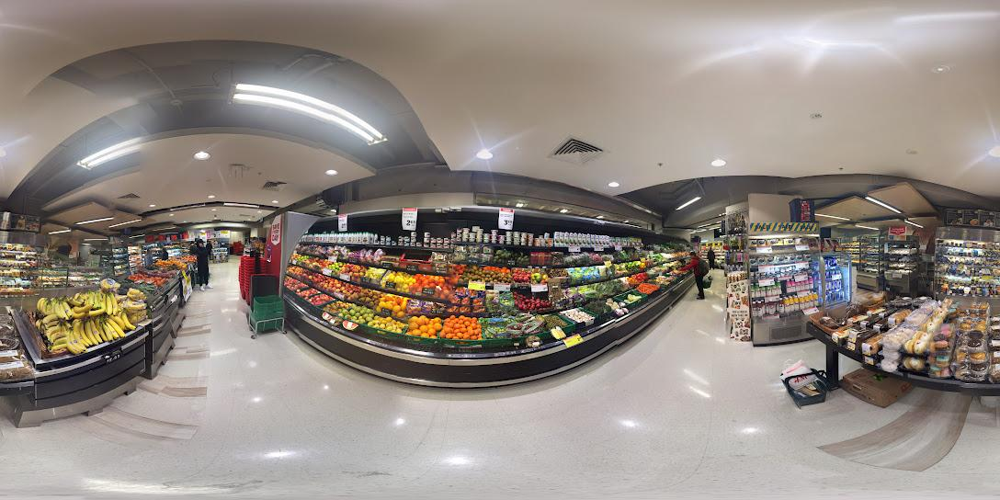

Output:
{'bikes': 0,
 'cars': 2,
 'environment': 'shops',
 'green': 5,
 'obscured': 25,
 'people': 3,
 'water': 0}




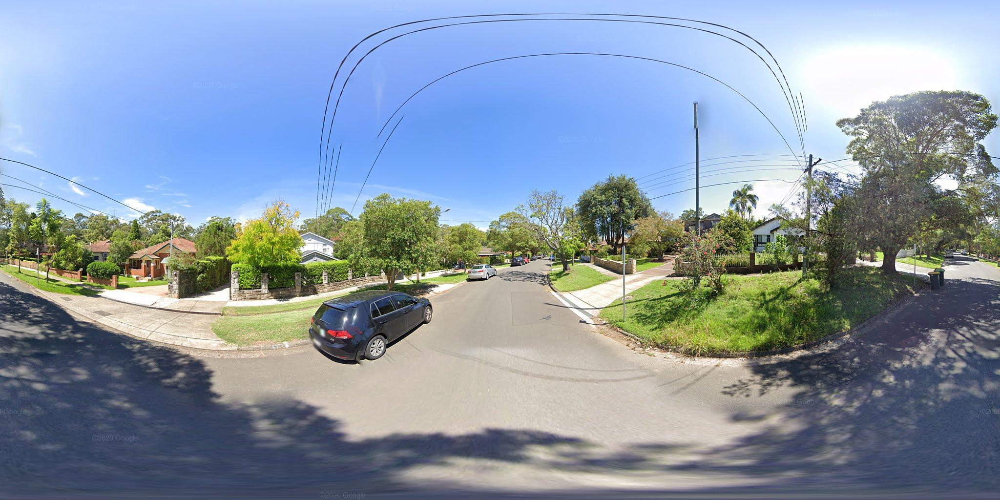

Output:
{'bikes': 0,
 'cars': 3,
 'environment': 'residential',
 'green': 60,
 'obscured': 30,
 'people': 0,
 'water': 0}




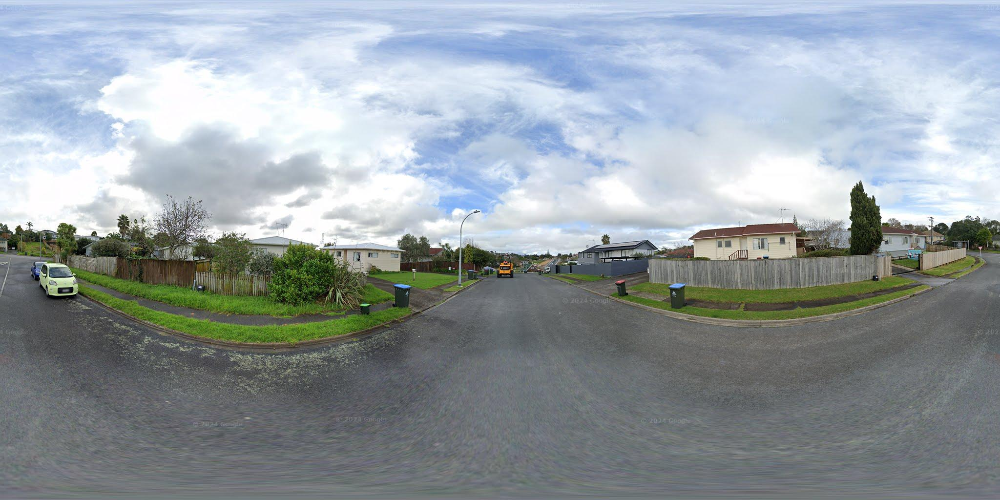

Output:
{'bikes': 0,
 'cars': 2,
 'environment': 'residential',
 'green': 54,
 'obscured': 55,
 'people': 0,
 'water': 0}




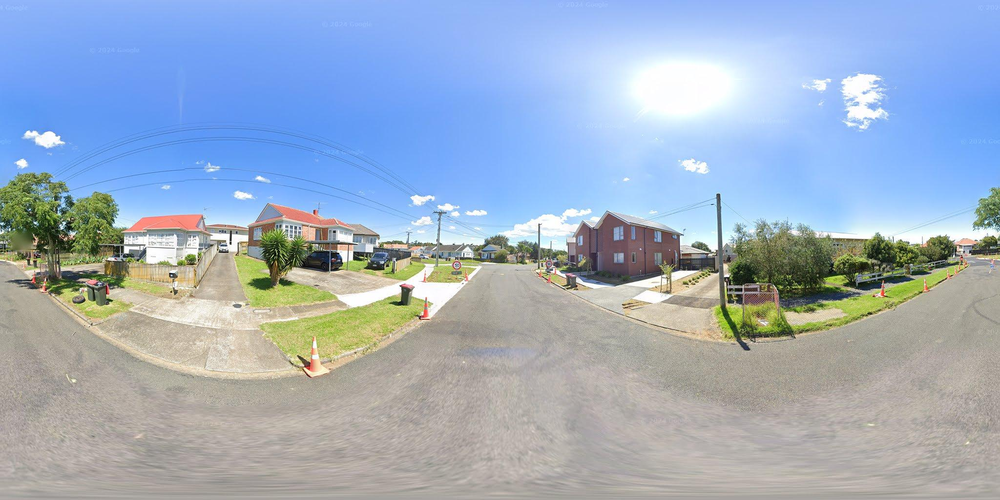

Output:
{'bikes': 0,
 'cars': 3,
 'environment': 'residential',
 'green': 40,
 'obscured': 20,
 'people': 0,
 'water': 0}




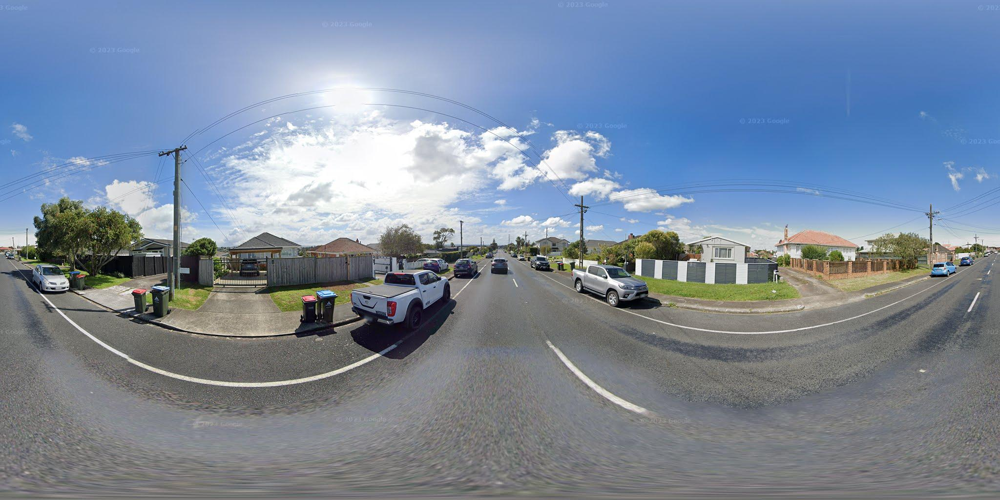

Output:
{'bikes': 0,
 'cars': 10,
 'environment': 'residential',
 'green': 30,
 'obscured': 40,
 'people': 0,
 'water': 0}




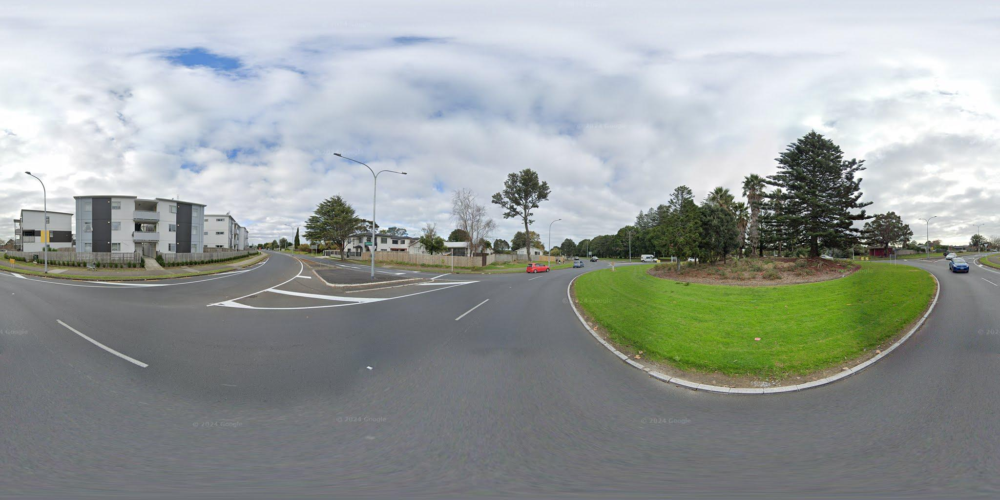

Output:
{'bikes': 0,
 'cars': 3,
 'environment': 'residential',
 'green': 60,
 'obscured': 50,
 'people': 0,
 'water': 0}




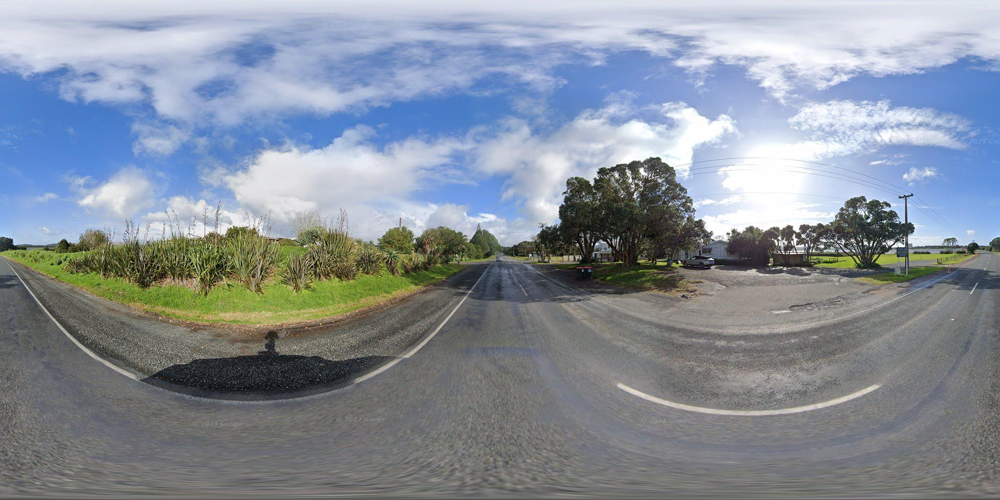

Output:
{'bikes': 0,
 'cars': 1,
 'environment': 'residential',
 'green': 30,
 'obscured': 50,
 'people': 0,
 'water': 0}




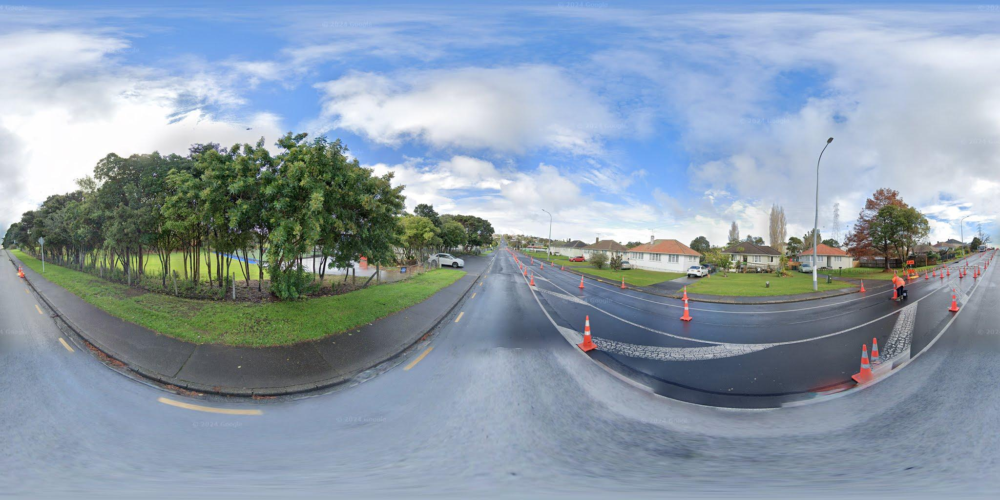

Output:
{'bikes': 0,
 'cars': 3,
 'environment': 'residential',
 'green': 43,
 'obscured': 0,
 'people': 0,
 'water': 0}




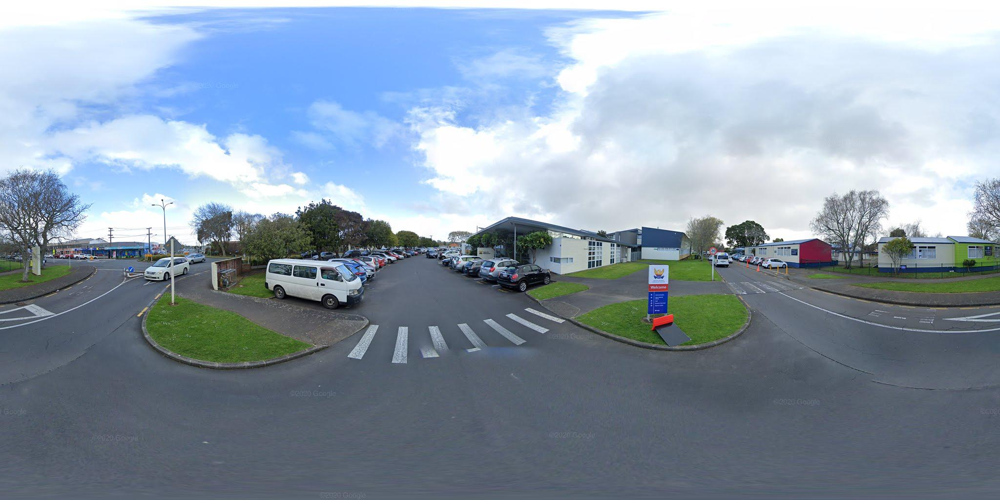

Output:
{'bikes': 0,
 'cars': 20,
 'environment': 'residential',
 'green': 40,
 'obscured': 30,
 'people': 1,
 'water': 0}




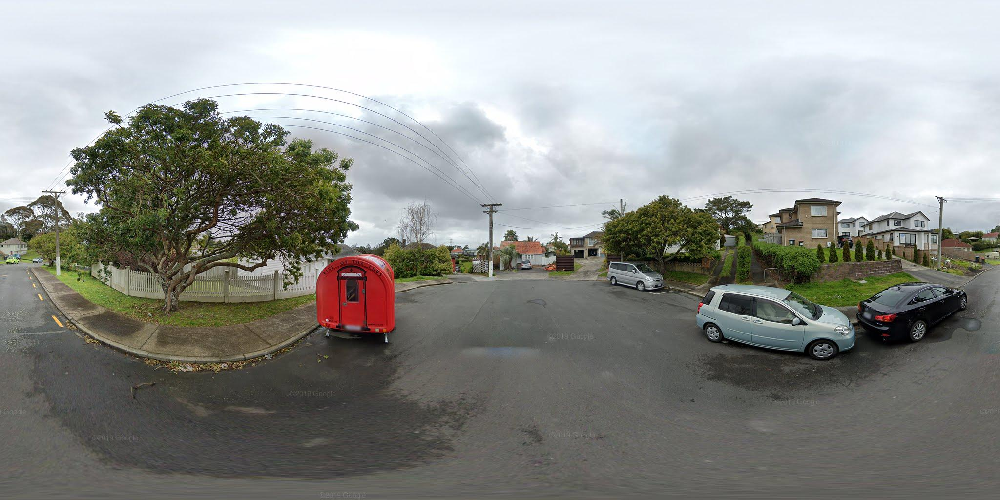

Output:
{'bikes': 0,
 'cars': 4,
 'environment': 'residential',
 'green': 53,
 'obscured': 40,
 'people': 0,
 'water': 0}




In [4]:
for row in tqdm(df.sample(10).itertuples(index=False)):
    panoid = row.panoid
    image = Image.open(f"panoramas/{panoid}.jpg")
    display(image)
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "text", "text": """
                    This image is a panorama from Google Street View.
                    From the image, extract the following information, in JSON format:
                    green: Percentage of the image that is green space (e.g. parks, gardens, trees, grass etc.). A number from 0-100.
                    environment: Classify the nature of the environment in this image. Built up/green/residential/shops/cafes?. A string.
                    water: If you see any streams/ponds/rivers/ocean in the image, estimate the distance to the water in meters. A number. If there is no water, return 0.
                    obscured: Proportion of view obscured by buildings (how much of total line of sight is blocked by buildings in close proximity). A number from 0-100.
                    people: the number of people you see in the image
                    cars: the number of cars you see in the image
                    bikes: the number of bikes you see in the image

                    Do not include comments in your JSON response. Only respond with the JSON object. Make sure the JSON is valid.
                """},
                {"type": "image"},
            ]
        }
    ]
    input_text = processor.apply_chat_template(messages, add_generation_prompt=True)
    inputs = processor(
        image,
        input_text,
        add_special_tokens=False,
        return_tensors="pt"
    ).to(model.device)

    for retry in range(3):
        output = model.generate(**inputs, max_new_tokens=5000)
        result = processor.decode(output[0])
        result = result[result.rindex("<|end_header_id|>") + len("<|end_header_id|>"):].strip().replace("<|eot_id|>", "")
        print("Output:")
        try:
            result = json.loads(result)
            pprint(result)
            print("\n")
            break
        except json.JSONDecodeError:
            print(f"Unable to parse: {result}")

In [6]:
results = []
for row in tqdm(df.itertuples(index=False), total=len(df)):
    panoid = row.panoid
    image = Image.open(f"panoramas/{panoid}.jpg")
    #display(image)
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "text", "text": """
                    This image is a panorama from Google Street View.
                    From the image, extract the following information, in JSON format:
                    green: Percentage of the image that is green space (e.g. parks, gardens, trees, grass etc.). A number from 0-100.
                    environment: Classify the nature of the environment in this image. Built up/green/residential/shops/cafes?. A string.
                    water: If you see any streams/ponds/rivers/ocean in the image, estimate the distance to the water in meters. A number. If there is no water, return 0.
                    obscured: Proportion of view obscured by buildings (how much of total line of sight is blocked by buildings in close proximity). A number from 0-100.
                    people: the number of people you see in the image
                    cars: the number of cars you see in the image
                    bikes: the number of bikes you see in the image

                    Do not include comments in your JSON response. Only respond with the JSON object. Make sure the JSON is valid.
                """},
                {"type": "image"},
            ]
        }
    ]
    input_text = processor.apply_chat_template(messages, add_generation_prompt=True)
    inputs = processor(
        image,
        input_text,
        add_special_tokens=False,
        return_tensors="pt"
    ).to(model.device)

    for retry in range(3):
        output = model.generate(**inputs, max_new_tokens=5000)
        result = processor.decode(output[0])
        result = result[result.rindex("<|end_header_id|>") + len("<|end_header_id|>"):].strip().replace("<|eot_id|>", "")
        #print("Output:")
        try:
            result = json.loads(result)
            #pprint(result)
            row = row._asdict()
            row.update(result)
            results.append(row)
            print("\n")
            break
        except json.JSONDecodeError:
            print(f"Unable to parse: {result}")

results = pd.DataFrame(results)
results.to_csv("LLM_results.csv", index=False)
results

  0%|          | 0/592 [00:00<?, ?it/s]

,Index,pid,n,time,anxiousness,latitude,longitude,geometry,panoid,panolat,panolon,panodate,green,environment,water,obscured,people,cars,bikes
0,0,P20001,1,2023-04-25T02:51:42Z,0,-36.924795,174.738044,POINT (174.7380435 -36.92479483),IvrcS0W1RlFAlnci-p39XA,-36.924665,174.737914,2012-04,70,residential,0,30,0,1,0
1,10,P20001,11,2023-04-24T00:42:25Z,0,-36.924837,174.737948,POINT (174.7379477 -36.92483659),QEpZV7bnO2mBfp0weMUKEg,-36.924730,174.737826,2012-04,50,residential,0,25,0,1,0
2,13,P20006,1,2023-06-03T02:45:55Z,3,-36.892203,174.740125,POINT (174.7401253 -36.89220256),omb98QNjTPWi0uUfMsmYeg,-36.892621,174.739961,2024-05,45,residential,0,30,0,2,0
3,15,P20009,2,2023-05-17T04:54:48Z,3,-36.923191,174.748620,POINT (174.7486203 -36.92319093),E7B5AV3DQ1rYWDClVRo8Zg,-36.923194,174.748831,2024-05,60,residential,0,30,1,6,0
4,19,P20009,6,2023-05-19T22:28:51Z,1,-36.923260,174.748655,POINT (174.748655 -36.92325959),KCTcsxYCIm41XdzkYEYUQw,-36.923286,174.748840,2024-05,24,residential,0,35,1,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
587,1421,P20693,2,2024-05-02T03:43:23Z,3,-36.897778,174.721580,POINT (174.7215796 -36.89777786),Uzuqd6oSo-EjCVuRP2Os0Q,-36.897742,174.721877,2022-06,50,residential,0,20,1,2,0
588,1425,P20693,6,2024-05-05T03:00:22Z,2,-36.969426,174.790602,POINT (174.7906024 -36.96942642),4OskePS4Ilz12JhsP-1ujg,-36.969164,174.790848,2022-08,40,residential,0,20,0,1,0
589,1426,P20721,1,2024-05-05T02:00:52Z,1,-36.893455,174.728262,POINT (174.728262 -36.89345532),CfRtPfDMNhfXHTNvMwnYRw,-36.893394,174.728062,2024-06,40,residential,0,20,1,1,0
590,1428,P20721,3,2024-05-05T23:06:27Z,2,-36.845252,174.759951,POINT (174.7599508 -36.8452515),AF1QipN2FD2eYEmK8bRpEgoM7fFl5-nUstwWujnRj0gv,-36.845292,174.759939,2022-06-24,10,built up,0,60,0,3,0
